# Cell type labeling, plotting, and differential gene expression analysis

## Notebook setup

In [1]:
from itertools import chain
from itertools import product
import numpy as np
import anndata as ad
import pandas as pd
import scanpy as sc
import scanpy.external as sce
# import scvelo as scv
# import cellrank as cr
# import harmonypy as harmony
import seaborn as sns
from scipy import io
from scipy import sparse

In [2]:
import gc
gc.enable()

In [3]:
import os
os.chdir('/local/workdir/dwm269/ma_ipsc/')

In [4]:
# Load metadata
meta = pd.read_csv("resources/metadata_v1.csv")
print(meta)

              sample                                           data.dir  \
0                 D0  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
1                 D1  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
2                 D4  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
3                 D6  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
4                 D8  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
5                D12  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
6                D21  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
7    D4_SmallPattern  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
8    D4_LargePattern  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
9   D21_SmallPattern  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
10  D21_LargePattern  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   

   patterm  pattern_int timepoint  time_int  
0    600um          600        D0         0  
1    60

## Load in preprocessed data

In [7]:
adata = sc.read_h5ad(
    filename="/workdir/dwm269/ma_ipsc/pyobjs/ma_iPSC_v2.h5ad"
)

In [8]:
adata.obs

,n_genes,n_counts,n_genes_by_counts,total_counts,total_counts_mito,pct_counts_mito,sample,data.dir,patterm,pattern_int,...,batch,S_score,G2M_score,phase,leiden_harmony,phate_harmony_density_timepoint,leiden_harmony_10,leiden_harmony_12,leiden_harmony_15,leiden_harmony_types
AAACCCAAGTGCAACG,4187,9578.0,4187,9578.0,777.0,8.112340,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,...,0,0.005916,0.309584,G2M,3,0.160585,1,0,0,iPSCs_1
AAACCCAAGTTGGAGC,3822,8510.0,3822,8510.0,766.0,9.001175,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,...,0,0.071151,0.522339,G2M,3,0.837935,1,0,0,iPSCs_1
AAACCCACATACCAGT,3936,8730.0,3936,8730.0,749.0,8.579610,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,...,0,0.138323,0.815391,G2M,3,0.532890,1,0,0,iPSCs_1
AAACCCACATAGAGGC,3084,5939.0,3084,5939.0,498.0,8.385250,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,...,0,0.218353,1.020387,G2M,3,0.789321,1,0,0,iPSCs_1
AAACCCAGTGCAACAG,2197,3992.0,2197,3992.0,327.0,8.191383,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,...,0,0.535403,0.284467,S,3,0.360347,1,0,0,iPSCs_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCAGACCTA,1595,2640.0,1595,2640.0,157.0,5.946970,D21_LargePattern,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,1000um,1000,...,10,-0.422341,-0.206852,G1,0,0.705617,5,3,3,Cardiomyocytes_5
TTTGTTGTCCAGTGTA,1942,3361.0,1942,3361.0,132.0,3.927402,D21_LargePattern,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,1000um,1000,...,10,-0.267514,-0.176221,G1,2,0.970399,3,1,10,Posterior_Foregut_Liver_3
TTTGTTGTCGTGCTCT,1607,2561.0,1607,2561.0,162.0,6.325654,D21_LargePattern,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,1000um,1000,...,10,-0.305713,-0.287770,G1,2,0.994021,3,1,5,Posterior_Foregut_Liver_3
TTTGTTGTCTACTGAG,4029,8918.0,4029,8918.0,286.0,3.206997,D21_LargePattern,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,1000um,1000,...,10,-0.296610,-0.492857,G1,2,0.577798,3,1,10,Posterior_Foregut_Liver_3


### Clustering summary plots

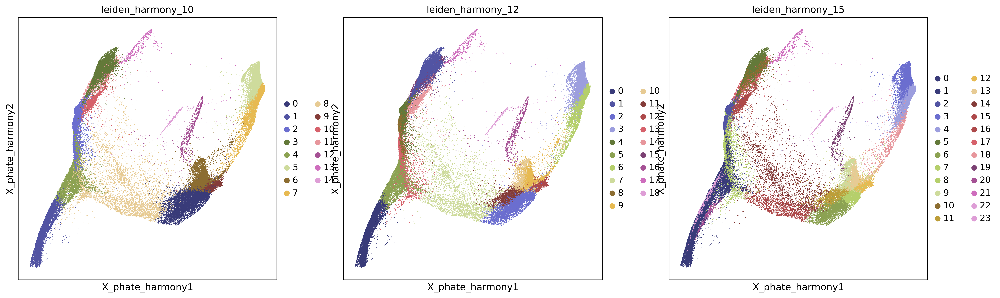

In [11]:
sc.set_figure_params(
    figsize=(6,6),
    fontsize=12,
    transparent=False,
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
#     color=['leiden_harmony_10'], 
    color=['leiden_harmony_10', 'leiden_harmony_12', 'leiden_harmony_15'], #'leiden_harmony',
#     color = ['APOA1','KDR', 'FAM184A','CDH2'],
#     color = ['GATA2','GATA3', 'GATA4','GATA6'],
#     color=['pattern_timepoint'],
#     edges=True, edges_width=0.01, 
#     edges=False, legend_loc='on data', legend_fontsize=6,legend_fontoutline=1, #labels on plot
    palette='tab20b',
    color_map='cividis',
    size=3,
    sort_order=True,
#     return_fig=True,
    ncols=3
)

## Annotate cell types

In [ ]:
# import csv
# reader = csv.DictReader(open('/workdir/dwm269/ma_ipsc/resources/ma_ipsc_gene_markers.csv'))
# marker_genes_dict = next(reader) 
# print(marker_genes_dict)

In [ ]:
## Canonical genes list
# Commented genes "not found"...
tmp_genes = {
    'iPSC':['POU5F1','NANOG','ST3GAL2','CDH1','EPCAM'],#,'SOX2'
    'Gastr_Cells_Prim_Streak': ['MIXL1','CER1','EOMES','SOX17','NODAL','APLNR','TBX6','HES7'],#'TBXT',
    'Posterior_PS':['ETV2','EVX1','ENG','TGFBR1'],
    'Mesendoderm_Prim_Endoderm':['SOX17','GATA4','GATA6','FOXA2'],#'SOX7',
    'Distal_Foregut_Pancreas':['PDX1','HHEX','MNX1','SOX9'],#'HNF6',
    'Posterior_Foregut_Liver':['ALB','CDH6','AFP','ONECUT2','HNF4A','FOXA1','FOXA2'],
    'Gut_Mesenchyme':['ALCAM','CDH1','CXCL12','PBX1','PITX2','LHX2','NCAM1','DES'],#'MEX2',
    'Endoderm_Gut_Cells':['ALB','CDH6','AFP','ONECUT2','HNF4A','NPPB'],
    'Stromal_Fibroblasts':['VIM','TAGLN2','COL1A1','COL3A1','TWIST1','PRRX1','THY1','POSTN'],
    'Mural_Cell':['RGS5','TAGLN','ANKRD1'],
    'Stromal_Smooth_Muscle':['ACTA2','TAGLN2','CNN1','SMTN','CALD1'],#'SM22','MYH11',
    'Cardiac_Mesoderm':['MESP1','EOMES','KDR','ISL1','MESP2'],#,'LHX1'
    'Endocardial':['TEK','NPC2','NPR3','NFATC1','PECAM1','CDH5','CD34','GATA5','TBX3'],#'TM4SF1',
    'Epicardial':['WT1','TBX18','TCF21','NR2F2'],
    'Cardiomyocytes':['ACTN2','MYH6','MYH7','MYL4','MYL7','TTN'],#'TNNT2',
    'First_Heart_Field':['TBX5','HCN4','HAND1'],
    'Second_Heart_Field':['HAND2','TBX1','CXCR4','TBX20'],
    'DEGs_old':['TGFBI','ANXA1','FBLN1','FOS','WNT6','GATA3','IGFBP7','CNTNAP2','SPARC','GAL'], #'IGFB',
    'DEGs_new':[
        'CDH11','TMEM88','PCDH11X','LINC00698','CD9','TMSB4X','CDH2','DKK1','CPED1','CXCL14',
                'TECRL','NRXN3','APOA1','GNG11','GABRP','ARHGAP29','KCNMA1','PTN','TMTC2','TIMP1','KCNQ5'
    ]
}

# KeyError: "Could not find keys '['HNF6', 'LHX1', 'MEX2', 'SM22', 'SOX2', 'SOX7', 'TBXT', 'TM4SF1', 'TNNT2']' in columns of `adata.obs` or in adata.var_names."

print(tmp_genes)

## DotPlot(s)

In [ ]:
sc.set_figure_params(
#     figsize=(6,6),
    transparent=True
)

tmp_cell_type='DEGs_new'

sc.pl.dotplot(
    adata_new,
    var_names=tmp_genes[tmp_cell_type], title=tmp_cell_type,
#     var_names=tmp_genes,
    groupby='leiden_harmony_types', 
#     layer="counts",
#     color_map="viridis",
    color_map='Greys',
    use_raw=False,
    standard_scale ='var',
#     swap_axes=True,
    dendrogram=False
)

## Label clusters

In [28]:
from pylab import *

cmap = cm.get_cmap('tab20b', 20)  # matplotlib color palette name, n colors

for i in range(cmap.N):
    rgb = cmap(i)[:3]  # will return rgba, we take only first 3 so we get rgb
    print(matplotlib.colors.rgb2hex(rgb))

#393b79
#5254a3
#6b6ecf
#9c9ede
#637939
#8ca252
#b5cf6b
#cedb9c
#8c6d31
#bd9e39
#e7ba52
#e7cb94
#843c39
#ad494a
#d6616b
#e7969c
#7b4173
#a55194
#ce6dbd
#de9ed6


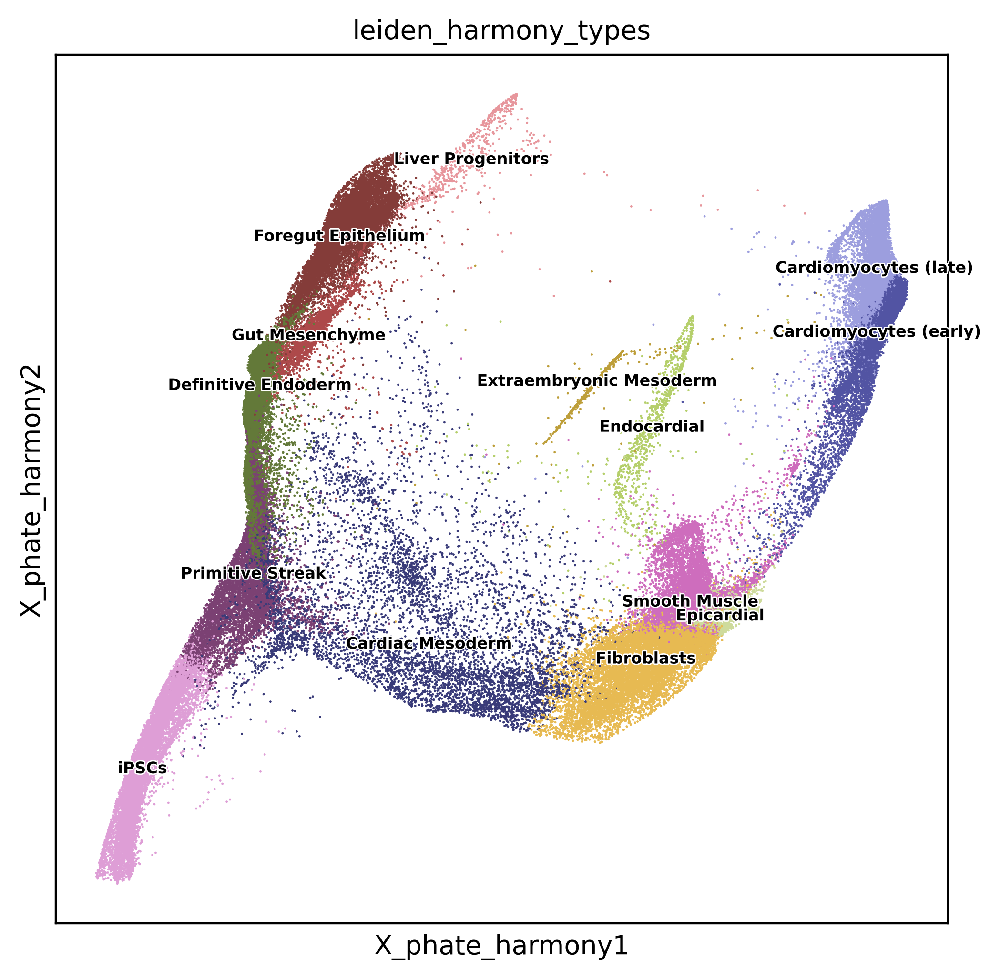

In [24]:
sc.set_figure_params(
    figsize=(6,6),
    fontsize=10,
    transparent=False,
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
#     color=['leiden_harmony_10'], 
    color=['leiden_harmony_types'],
#     edges=True, edges_width=0.01, 
    edges=False, legend_loc='on data', legend_fontsize=6,legend_fontoutline=1, #labels on plot
    palette='tab20b',
    color_map='cividis',
    size=3,
    sort_order=True,
#     return_fig=True,
    ncols=3
)

In [29]:
# Set cell types based on leiden clustering of harmony embedding
## Using resolution value of 1.0

# old_cluster_names = [
#     'Stromal (HAND1+)', # 0
#     'iPSCs_1', #1
#     'Mesendoderm_2', #2
#     'Posterior_Foregut_Liver_3', #3
#     'Gastr_Cells_Prim_Streak', #4
#     'Cardiomyocytes_5', #5
#     'Stromal_Smooth_Muscle_6', #6
#     'Cardiomyocytes_7', #7
#     'Cardiac_Mesoderm_8', #8
#     'Epicardial (SPARC+)', #9
#     'Stromal (ANKRD1+)', #10
#     'Posterior_Foregut_Liver_11', #11
#     'Endocardial_12', #12
#     'Posterior_Foregut_Liver_13', #13
#     'Unknown_14' #14
# ]

old_to_new = {
    '0':'Fibroblasts', # 0
    '1':'iPSCs', #1
    '2':'Definitive Endoderm', #2
    '3':'Foregut Epithelium', #3
    '4':'Primitive Streak', #4
    '5':'Cardiomyocytes (late)', #5
    '6':'Smooth Muscle', #6
    '7':'Cardiomyocytes (early)', #7
    '8':'Cardiac Mesoderm', #8
    '9':'Epicardial', #9
    '10':'Gut Mesenchyme', #10
    '11':'Gut Mesenchyme', #11
    '12':'Endocardial', #12
    '13':'Liver Progenitors', #13
    '14':'Extraembryonic Mesoderm' #14
}

adata.obs['leiden_harmony_types'] = (
    adata.obs['leiden_harmony_10'].map(old_to_new).astype('category')
)

In [ ]:
# PHATE, split by timepoint


## Differential expression testing

#### Cardiomyocytes

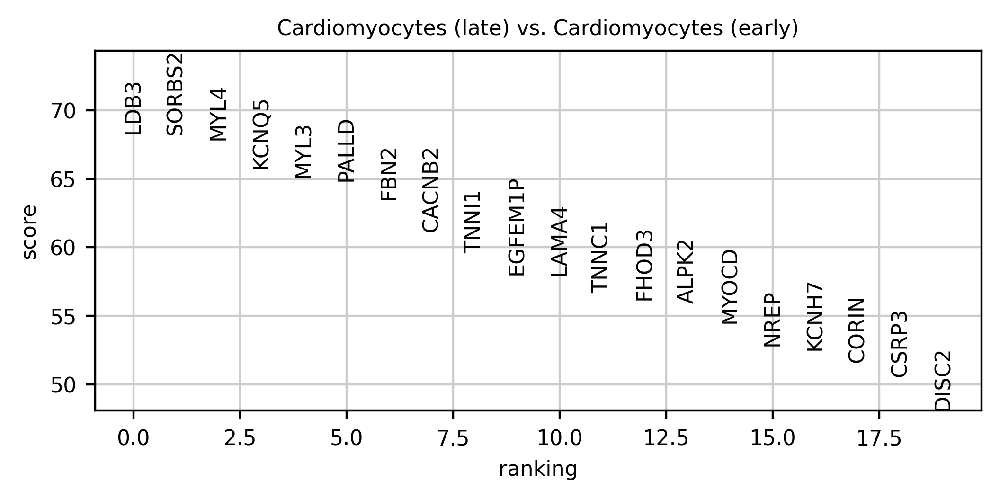

In [69]:
## Early vs. late cardiomyocytes (Wilcoxon)
sc.tl.rank_genes_groups(
    adata,
    groupby='leiden_harmony_types',
    groups=['Cardiomyocytes (late)'],
    reference='Cardiomyocytes (early)',
    method='wilcoxon'
)

# visualize the results
sc.set_figure_params(
    figsize=(6,2.5),
    fontsize=8,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups(
    adata,
    groups=['Cardiomyocytes (late)'],
    n_gene=30,
    ncols=5
)

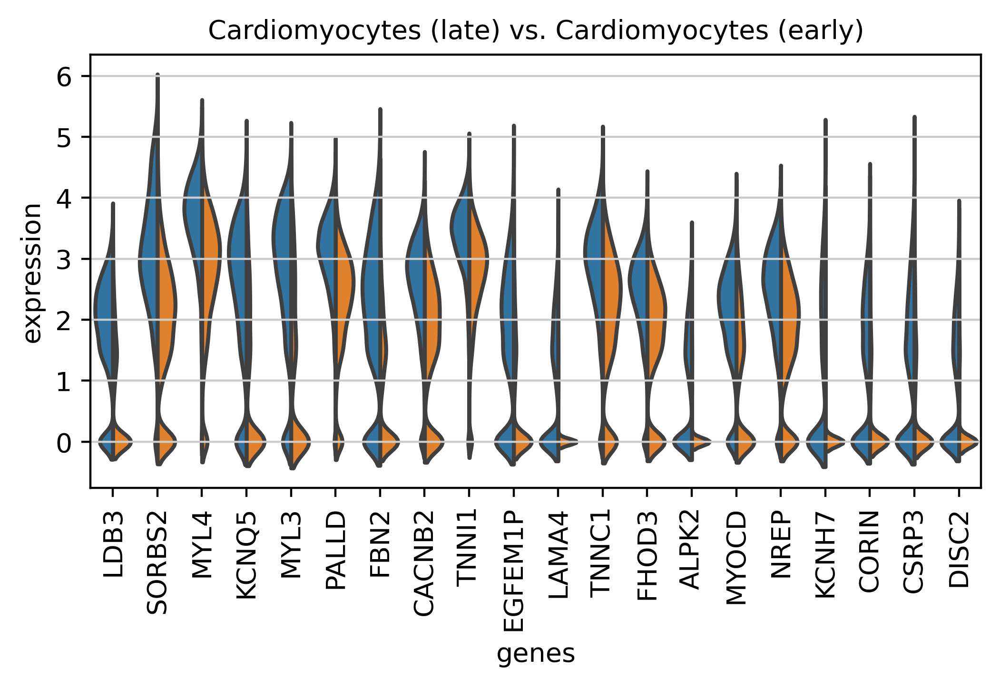

In [70]:
sc.set_figure_params(
    figsize=(6,3),
    fontsize=10,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups_violin(
    adata, 
    groups=['Cardiomyocytes (late)'],
    n_genes=20,
    size=0
)

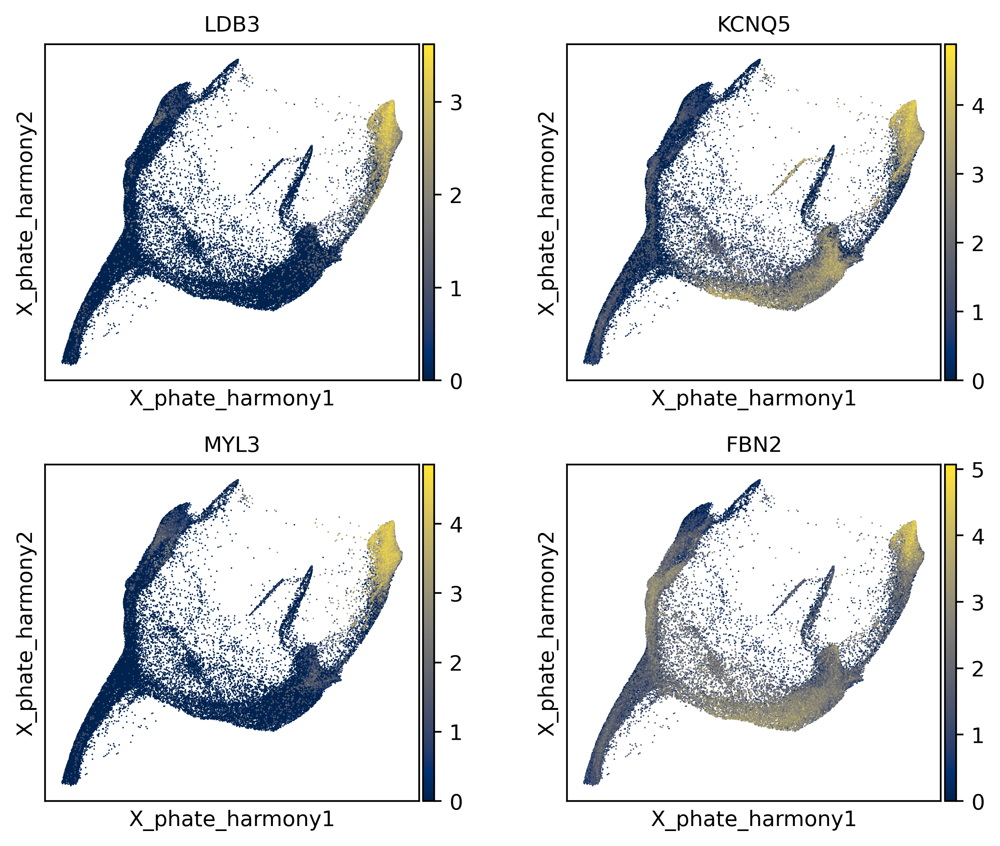

In [71]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=10,
    transparent=False,
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color=['LDB3','KCNQ5','MYL3','FBN2'],
    color_map='cividis',
    size=2,
    sort_order=True,
    ncols=2
)

#### Gut mesenchyme vs. foregut epithelium

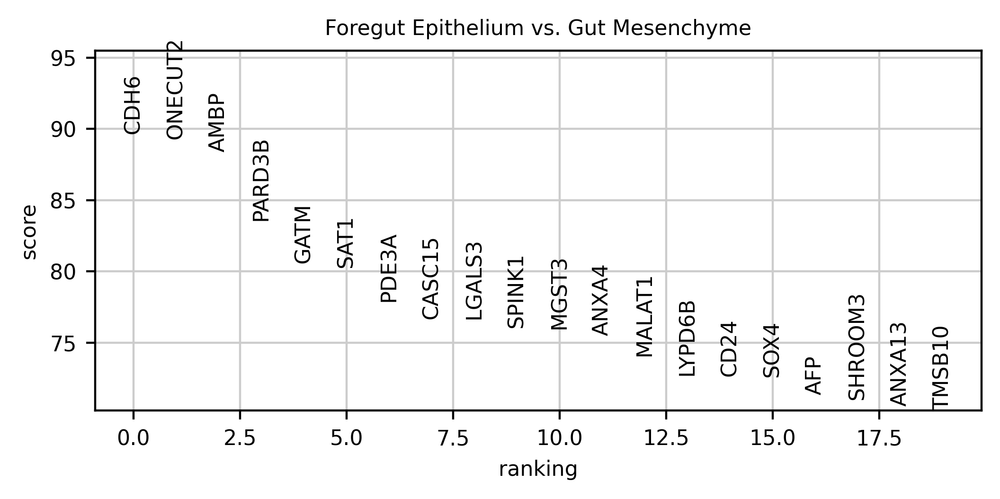

In [67]:
## Gut mesenchyme vs. foregut epithelium (Wilcoxon)
sc.tl.rank_genes_groups(
    adata,
    groupby='leiden_harmony_types',
    groups=['Foregut Epithelium'],
    reference='Gut Mesenchyme',
    method='wilcoxon'
)

# visualize the results
sc.set_figure_params(
    figsize=(6,2.5),
    fontsize=8,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups(
    adata,
    groups=['Foregut Epithelium'],
    n_gene=20,
    ncols=5
)

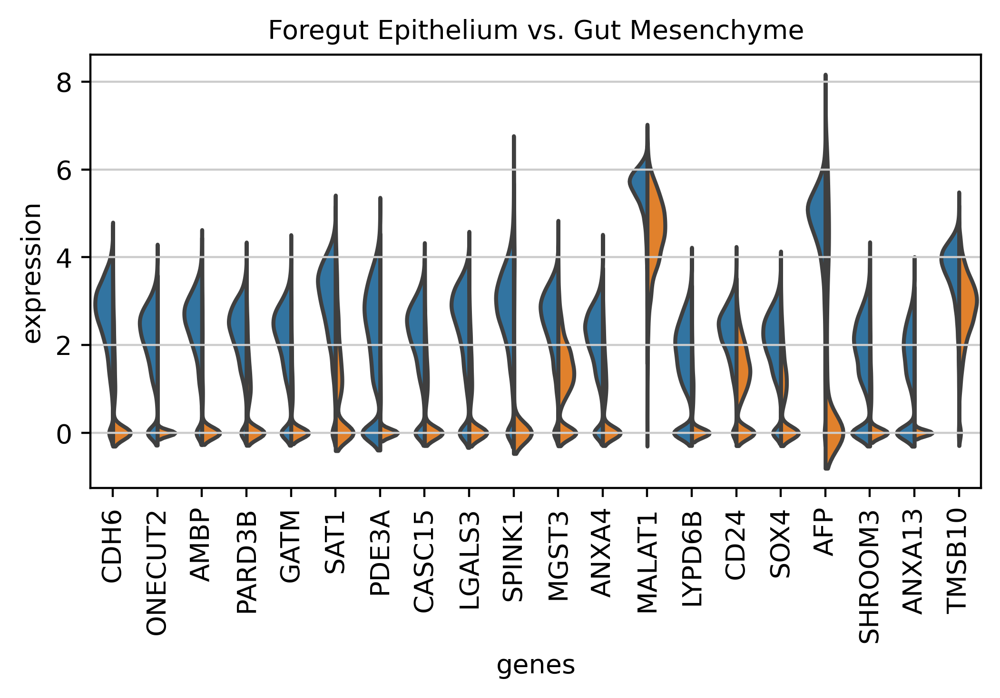

In [68]:
sc.set_figure_params(
    figsize=(6,3),
    fontsize=10,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups_violin(
    adata, 
    groups=['Foregut Epithelium'],
    n_genes=20,
    size=0
)

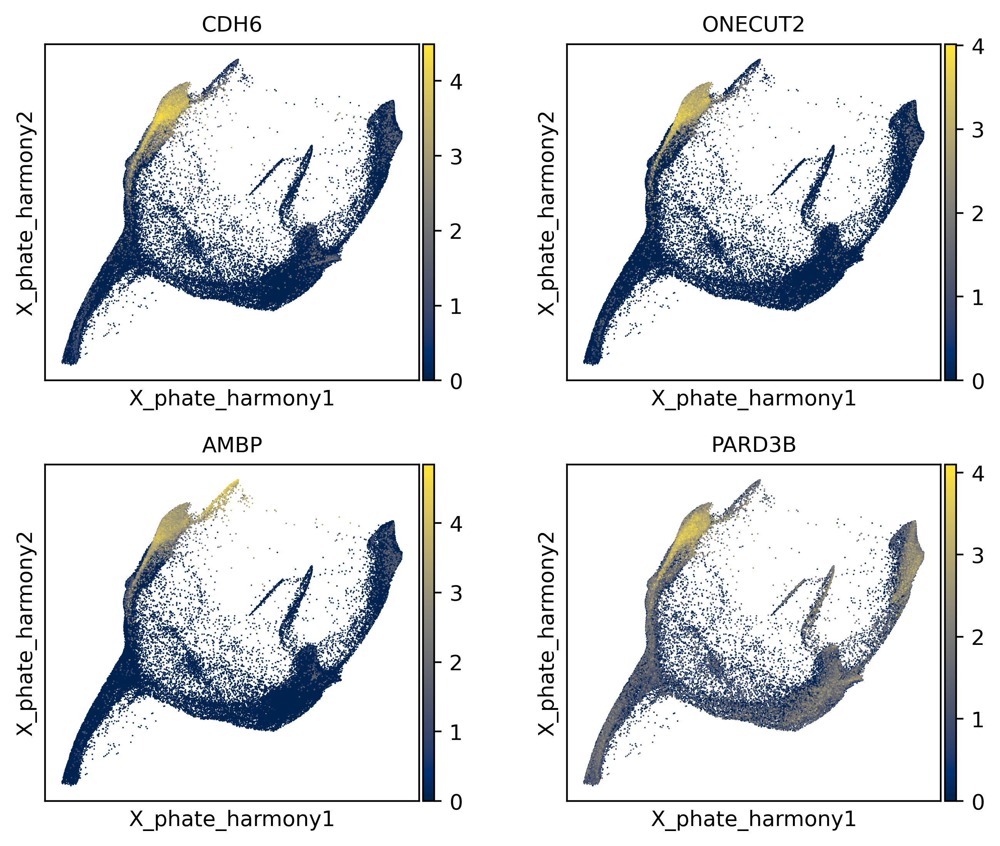

In [73]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=10,
    transparent=False,
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color=['CDH6','ONECUT2','AMBP','PARD3B'],
#     edges=True, edges_width=0.01, 
#     edges=False, legend_loc='on data', legend_fontsize=6,legend_fontoutline=1, #labels on plot
    palette='tab20b',
    color_map='cividis',
    size=2,
    sort_order=True,
#     return_fig=True,
    ncols=2
)

### Liver progenitors vs. Foregut epithelium

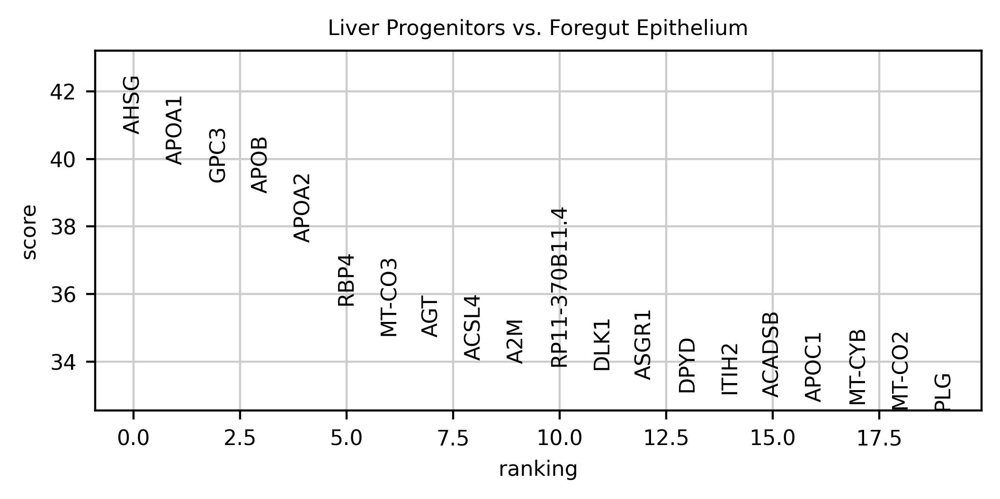

In [74]:
## Gut mesenchyme vs. foregut epithelium (Wilcoxon)
sc.tl.rank_genes_groups(
    adata,
    groupby='leiden_harmony_types',
    groups=['Liver Progenitors'],
    reference='Foregut Epithelium',
    method='wilcoxon'
)

# visualize the results
sc.set_figure_params(
    figsize=(6,2.5),
    fontsize=8,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups(
    adata,
    groups=['Liver Progenitors'],
    n_gene=20,
    ncols=5
)

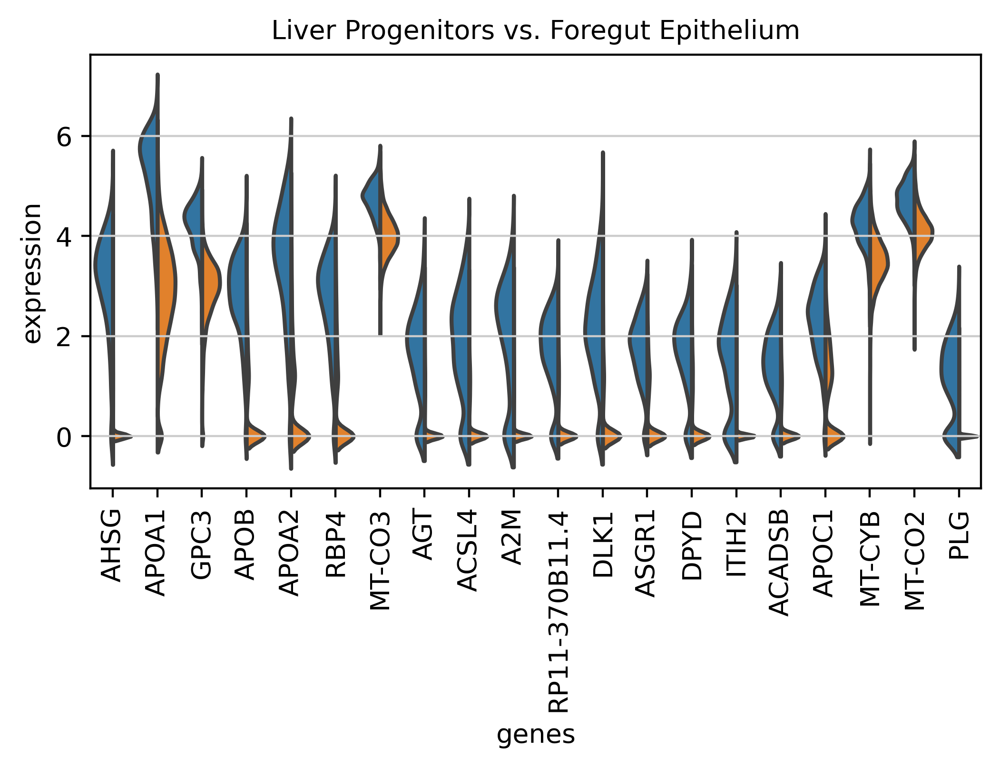

In [75]:
sc.set_figure_params(
    figsize=(6,3),
    fontsize=10,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups_violin(
    adata, 
    groups=['Liver Progenitors'],
    n_genes=20,
    size=0
)

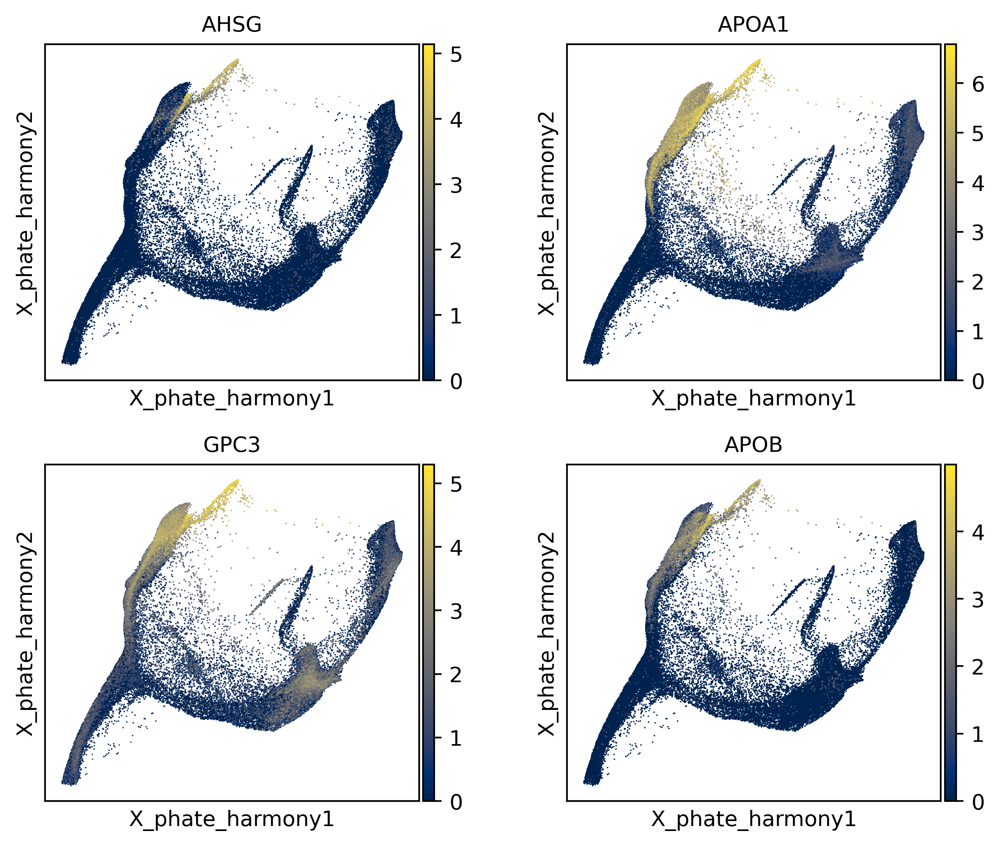

In [76]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=10,
    transparent=False,
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color=['AHSG','APOA1','GPC3','APOB'],
#     edges=True, edges_width=0.01, 
#     edges=False, legend_loc='on data', legend_fontsize=6,legend_fontoutline=1, #labels on plot
    palette='tab20b',
    color_map='cividis',
    size=2,
    sort_order=True,
#     return_fig=True,
    ncols=2
)

### Cardiac mesoderm vs. primitive streak

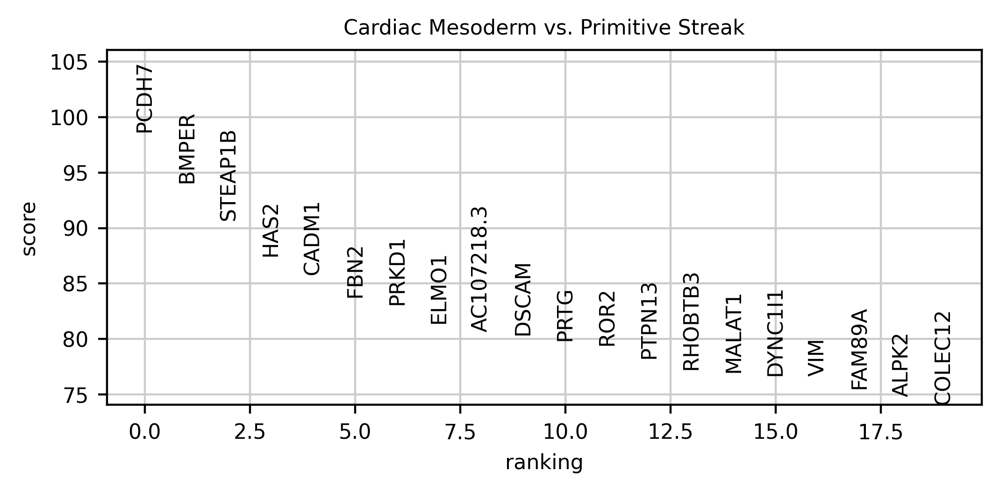

In [61]:
## vs. (Wilcoxon)
sc.tl.rank_genes_groups(
    adata,
    groupby='leiden_harmony_types',
    groups=['Cardiac Mesoderm'],
    reference='Primitive Streak',
    method='wilcoxon'
)

# visualize the results
sc.set_figure_params(
    figsize=(6,2.5),
    fontsize=8,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups(
    adata,
    groups=['Cardiac Mesoderm'],
    n_gene=30,
    ncols=5
)

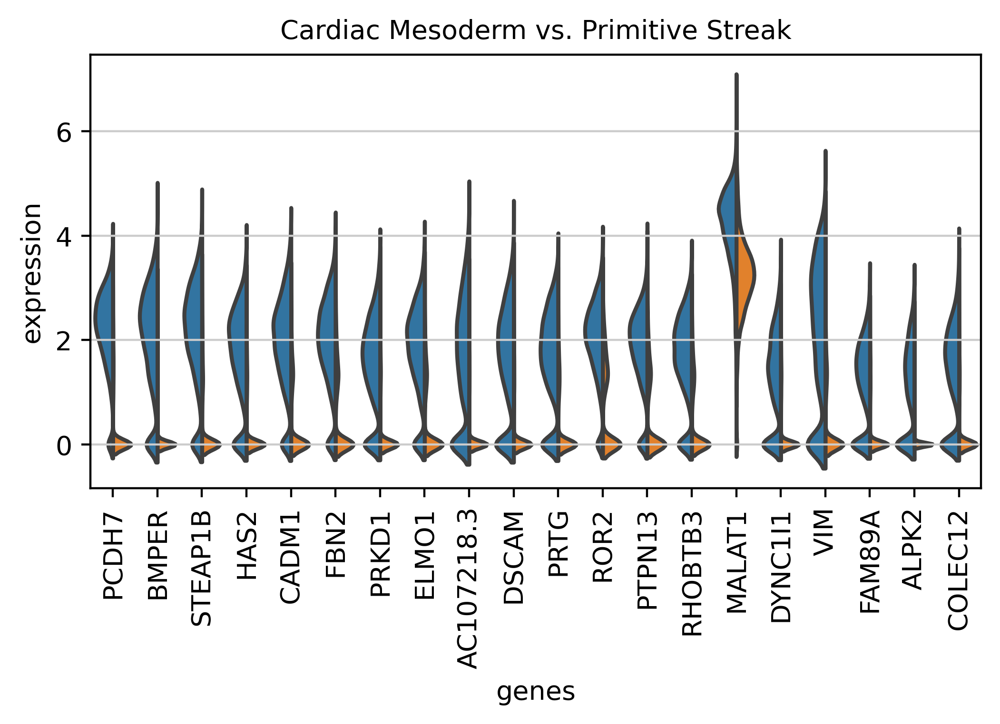

In [62]:
sc.set_figure_params(
    figsize=(6,3),
    fontsize=10,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups_violin(
    adata, 
    groups=['Cardiac Mesoderm'],
    n_genes=20,
    size=0
)

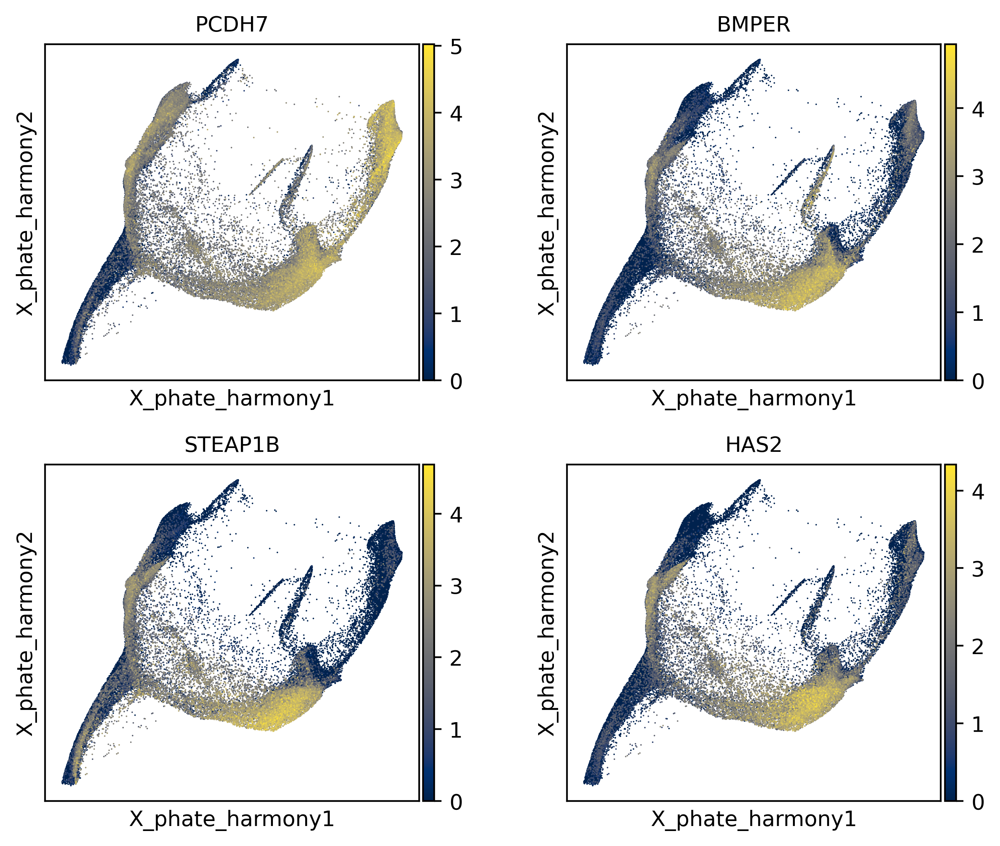

In [65]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=10,
    transparent=False,
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color=['PCDH7','BMPER','STEAP1B','HAS2'],
#     edges=True, edges_width=0.01, 
#     edges=False, legend_loc='on data', legend_fontsize=6,legend_fontoutline=1, #labels on plot
    palette='tab20b',
    color_map='cividis',
    size=2,
    sort_order=True,
#     return_fig=True,
    ncols=2
)

### Definitive endoderm vs. primitive streak

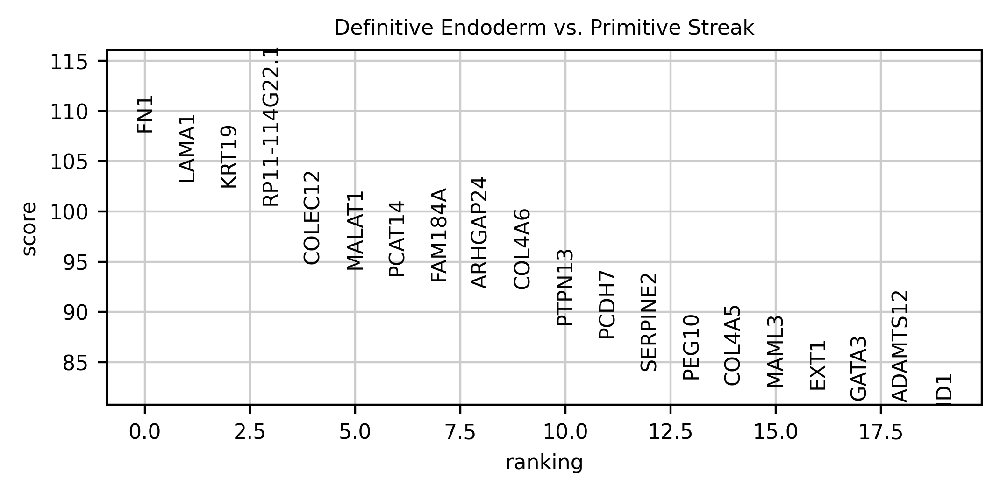

In [63]:
## Early vs. late cardiomyocytes (Wilcoxon)
sc.tl.rank_genes_groups(
    adata,
    groupby='leiden_harmony_types',
    groups=['Definitive Endoderm'],
    reference='Primitive Streak',
    method='wilcoxon'
)

# visualize the results
sc.set_figure_params(
    figsize=(6,2.5),
    fontsize=8,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups(
    adata,
    groups=['Definitive Endoderm'],
    n_gene=30,
    ncols=5
)

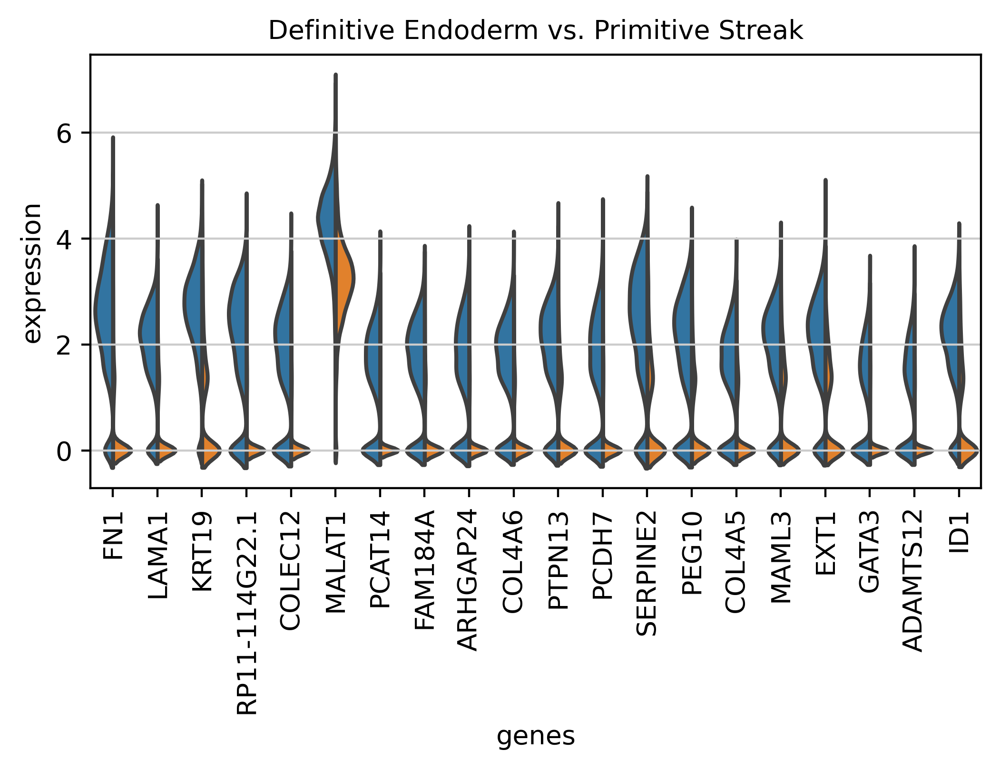

In [64]:
sc.set_figure_params(
    figsize=(6,3),
    fontsize=10,
    transparent=True,
    dpi=200
)
sc.pl.rank_genes_groups_violin(
    adata, 
    groups=['Definitive Endoderm'],
    n_genes=20,
    size=0
)

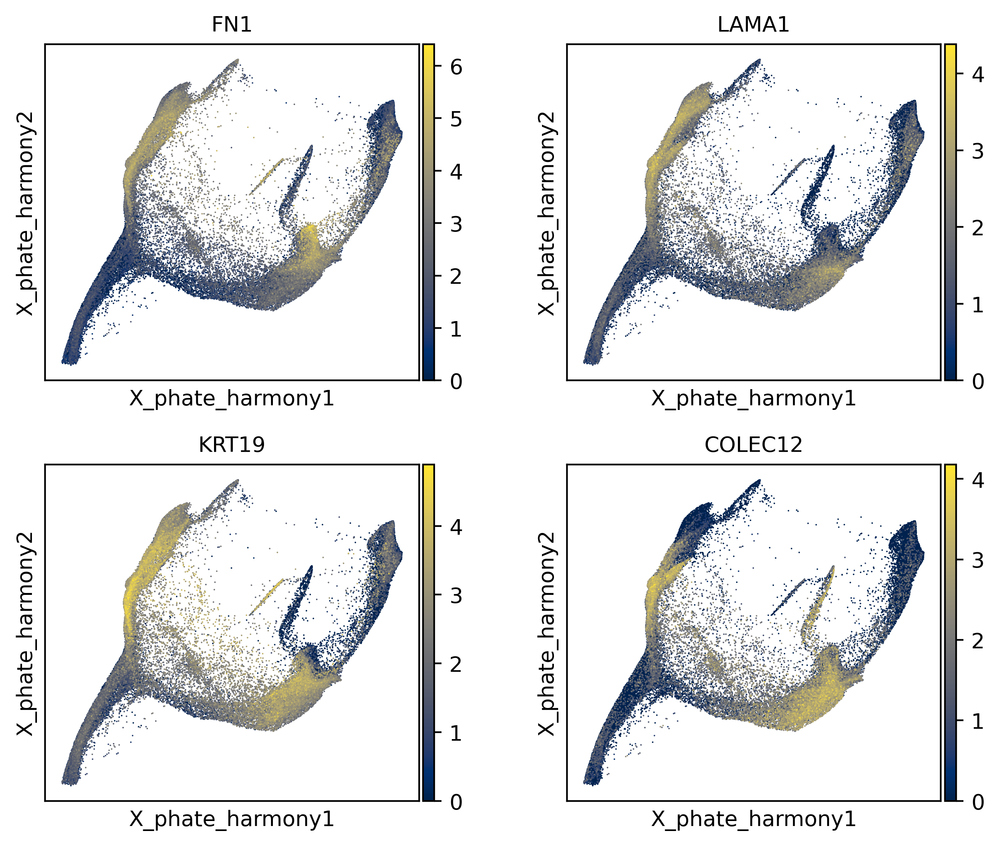

In [66]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=10,
    transparent=False,
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color=['FN1','LAMA1','KRT19','COLEC12'],
#     edges=True, edges_width=0.01, 
#     edges=False, legend_loc='on data', legend_fontsize=6,legend_fontoutline=1, #labels on plot
    palette='tab20b',
    color_map='cividis',
    size=2,
    sort_order=True,
#     return_fig=True,
    ncols=2
)

## Save preprocessed object for future analyses (python & R)

In [57]:
# Save h5ad object for subsequent python analyses
adata.write("pyobjs/ma_iPSC_v2.h5ad")

# Save Seurat compatible object for subsequent R analyses
#TODO
# https://mojaveazure.github.io/seurat-disk/articles/convert-anndata.html